In [ ]:
import os, sys 
#to be able to interact with Google Drive's operating system
from google.colab import drive 
#drive is a module that allows us use Python to interact with google drive
drive.mount('/content/gdrive') 
#mounting google drive allows us to work with its contents
nb_path = '/content/notebooks'
os.symlink('/content/gdrive/My Drive/Colab Notebooks', nb_path)
sys.path.insert(0, nb_path)  # or append(nb_path)

In [7]:
import pandas as pd
import numpy as np
from epigenomic_dataset import active_promoters_vs_inactive_promoters
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers
import matplotlib.pyplot as plt
from cache_decorator import Cache
from typing import Dict, List, Tuple, Optional
import seaborn as sns
from scipy.stats import pearsonr, spearmanr, entropy, wilcoxon
from minepy import MINE
from tqdm.auto import tqdm
from sklearn.metrics.pairwise import euclidean_distances
from typing import Tuple

from tensorflow.keras.layers import Input, Dense, Dropout, BatchNormalization, ReLU, Concatenate, Layer
from tensorflow.keras.layers import Conv1D, MaxPool1D, GlobalAveragePooling2D, GlobalMaxPool1D, Flatten,Reshape,ReLU, GlobalAveragePooling1D,ActivityRegularization
from tensorflow.keras import regularizers,Sequential
from tensorflow.keras.models import Model,Sequential
from extra_keras_metrics import get_complete_binary_metrics
from tensorflow.keras.callbacks import EarlyStopping
from epigenomic_dataset.utils import normalize_epigenomic_data
from keras_mixed_sequence import MixedSequence, VectorSequence
from keras_bed_sequence import BedSequence
from epigenomic_dataset.utils import get_cell_lines

In [1]:
import warnings
warnings.filterwarnings('ignore')


# **RETRIEVAL OF ENCODE EPIGENOMIC DATA**

We use the *epigenomic_dataset* Python package to extract epigenomic data relative to HEK293 cell line and  hg38 assembly genome. 

In [8]:
window_size = 256
cell_line="HEK293"
assembly = "hg38"

In [52]:
promoters_epigenomes, promoters_labels = active_promoters_vs_inactive_promoters(
    cell_line = cell_line,
    dataset = "fantom",
    window_size = window_size,
    binarize = True,
    min_active_tpm_value = 1,
    max_inactive_tpm_value = 1,
    
)

enhancers_epigenomes, enhancers_labels = active_enhancers_vs_inactive_enhancers(
    cell_line = cell_line,
    dataset = "fantom",
    window_size = window_size,
    binarize = True,
    min_active_tpm_value = 0,
    max_inactive_tpm_value = 0,
)

In [53]:
epigenomes = {
    "promoters": promoters_epigenomes,
    "enhancers": enhancers_epigenomes
}

labels = {
    "promoters": promoters_labels,
    "enhancers": enhancers_labels
}

In [54]:
labels['promoters']['HEK293'] = labels['promoters']['HEK293'].replace([False,True],[0,1])

In [55]:
labels['enhancers']['HEK293'] = labels['enhancers']['HEK293'].replace([False,True],[0,1])

# **RATE BETWEEN FEATURES AND SAMPLES**


To avoid overfitting, it is important that the number of samples is greater than the number of features

In [56]:
for region, x in epigenomes.items():
    print(
        f"The rate between features and samples for {region} data is: {x.shape[0]/x.shape[1]}"
    )
   

The rate between features and samples for promoters data is: 509.5969387755102
The rate between features and samples for enhancers data is: 322.8826530612245


# **GENOMIC SEQUENCE RETRIEVAL**

In order to retrieve sequence data, we use the *ucsc_genomes_downloader* python package.

In [9]:
from ucsc_genomes_downloader import Genome

genome = Genome(assembly)

Loading chromosomes for genome hg38:   0%|          | 0/25 [00:00<?, ?it/s]

In [ ]:
print("The chromosomes in the human genome are: {}.".format(", ".join(genome)))

The chromosomes in the human genome are: chr1, chrM, chr21, chr22, chrY, chr19, chr20, chr18, chr17, chr16, chr15, chr14, chr13, chr12, chr10, chr11, chr9, chr8, chrX, chr7, chr6, chr5, chr4, chr3, chr2.


In [10]:
def to_bed(data:pd.DataFrame)->pd.DataFrame:
    """Return bed coordinates from given dataset."""
    return data.reset_index()[data.index.names]

#display(to_bed(epigenomes["promoters"])[:5])

In [57]:
genome.bed_to_sequence(to_bed(epigenomes["promoters"])[:2])

array(['AAATGGTCATCCATCCTTTGGCCCCAATACCTAAACTAAGGTCTATGAACAATAAGATGATTTTCTTCAGTGGGACTTTTTTGTTTAATATATTAGATTTGACCTTCAGCAAGGTCAAAGGGAGTCCGAACTAGTCTCAGGCTTCAACATCGAATACGCCGCAGGCCCCTTCGCCCTATTCTTCATAGCCGAATACACAAACATTATTATAATAAACACCCTCACCACTACAATCTTCCTAGGAACAACATATAAC',
       'CAATAAGATGATTTTCTTCAGTGGGACTTTTTTGTTTAATATATTAGATTTGACCTTCAGCAAGGTCAAAGGGAGTCCGAACTAGTCTCAGGCTTCAACATCGAATACGCCGCAGGCCCCTTCGCCCTATTCTTCATAGCCGAATACACAAACATTATTATAATAAACACCCTCACCACTACAATCTTCCTAGGAACAACATATAACGCACTCTCCCCTGAACTCTACACAACATATTTTGTCACCAAGACCCTAC'],
      dtype='<U256')

In [58]:
from keras_bed_sequence import BedSequence

def one_hot_encode(genome:Genome, data:pd.DataFrame, nucleotides:str="actg")->np.ndarray:
    return np.array(BedSequence(
        genome,
        bed=to_bed(data),
        nucleotides=nucleotides,
        batch_size=1
    ))

one_hot_encode(genome, epigenomes["promoters"][:2])

array([[[[0., 1., 0., 0.],
         [1., 0., 0., 0.],
         [1., 0., 0., 0.],
         ...,
         [0., 0., 1., 0.],
         [1., 0., 0., 0.],
         [0., 1., 0., 0.]]],


       [[[1., 0., 0., 0.],
         [1., 0., 0., 0.],
         [1., 0., 0., 0.],
         ...,
         [1., 0., 0., 0.],
         [1., 0., 0., 0.],
         [0., 1., 0., 0.]]]])

# **IMPUTATION**

The presenece of missing values (or Nan values) inside the dataset can influence in a negative way the performance of the model. Thanks to imputation, we replace Nan values of the epigenomic dataset with sobstituted values, calculated through K-nearest-neighbour(K-NN) algorithm. 

In [59]:
print("\n".join((
    f"Nan values report for  promoters data:",
    f"In the document there are {epigenomes['promoters'].isna().values.sum()} NaN values out of {epigenomes['promoters'].values.size} values.",
    f"The sample (row) with most values has {epigenomes['promoters'].isna().sum(axis=1).max()} NaN values out of {epigenomes['promoters'].shape[1]} values.",
    f"The feature (column) with most values has {epigenomes['promoters'].isna().sum().max()} NaN values out of {epigenomes['promoters'].shape[0]} values."
)))
print("*"*80)
print("\n".join((
    f"Nan values report for  enhancers data:",
    f"In the document there are {epigenomes['enhancers'].isna().values.sum()} NaN values out of {epigenomes['enhancers'].values.size} values.",
    f"The sample (row) with most values has {epigenomes['enhancers'].isna().sum(axis=1).max()} NaN values out of {epigenomes['enhancers'].shape[1]} values.",
    f"The feature (column) with most values has {epigenomes['enhancers'].isna().sum().max()} NaN values out of {epigenomes['enhancers'].shape[0]} values."
)))

Nan values report for  promoters data:
In the document there are 0 NaN values out of 19576676 values.
The sample (row) with most values has 0 NaN values out of 196 values.
The feature (column) with most values has 0 NaN values out of 99881 values.
********************************************************************************
Nan values report for  enhancers data:
In the document there are 1 NaN values out of 12403860 values.
The sample (row) with most values has 1 NaN values out of 196 values.
The feature (column) with most values has 1 NaN values out of 63285 values.


In [11]:
from sklearn.impute import KNNImputer

def knn_imputation(df:pd.DataFrame, neighbours:int=5)->pd.DataFrame:
    return pd.DataFrame(
        KNNImputer(n_neighbors=neighbours).fit_transform(df.values),
        columns=df.columns,
        index=df.index
    )

In [60]:
epigenomes = {
    "promoters": promoters_epigenomes,
    "enhancers": knn_imputation(enhancers_epigenomes)
}




In [61]:
print("\n".join((
    f"Nan values report for  promoters data:",
    f"In the document there are {epigenomes['enhancers'].isna().values.sum()} NaN values out of {knn_imputation(epigenomes['enhancers']).values.size} values.",
    f"The sample (row) with most values has {epigenomes['enhancers'].isna().sum(axis=1).max()} NaN values out of {knn_imputation(epigenomes['enhancers']).shape[1]} values.",
    f"The feature (column) with most values has {epigenomes['enhancers'].isna().sum().max()} NaN values out of {knn_imputation(epigenomes['enhancers']).shape[0]} values."
)))

Nan values report for  promoters data:
In the document there are 0 NaN values out of 12403860 values.
The sample (row) with most values has 0 NaN values out of 196 values.
The feature (column) with most values has 0 NaN values out of 63285 values.


# **FINDING CONSTANT FEATURES**

In [62]:
def drop_constant_features(df:pd.DataFrame)->pd.DataFrame:
    """Return DataFrame without constant features."""
    return df.loc[:, (df != df.iloc[0]).any()]

In [63]:
print(drop_constant_features(epigenomes['promoters']).shape != epigenomes['promoters'].shape)
(drop_constant_features(epigenomes['enhancers']).shape != epigenomes['enhancers'].shape)

False


False

# **FEATURE SCALING**

In Machine Learning, feature scaling is very important because it makes sure that the features of the dataset are measured on the same scale. 
We will apply Robust Scaler which removes the median and scales the data according to the quantile range.

In [64]:
from sklearn.preprocessing import RobustScaler

def robust_zscoring(df:pd.DataFrame)->pd.DataFrame:
    """Return given dataframe scaled using robust z-scoring."""
    return pd.DataFrame(
        RobustScaler().fit_transform(df.values),
        columns=df.columns,
        index=df.index
    )

In [65]:
epigenomes['promoters']=robust_zscoring(epigenomes['promoters'])
epigenomes['enhancers']=robust_zscoring(epigenomes['enhancers'])

## **CLASS IMBALANCE**

Class imbalance can affect the model's performance: if the number of samples belonging to a class exceeds the number of examples inside the other, the classifier will probably end to predict the most present class.

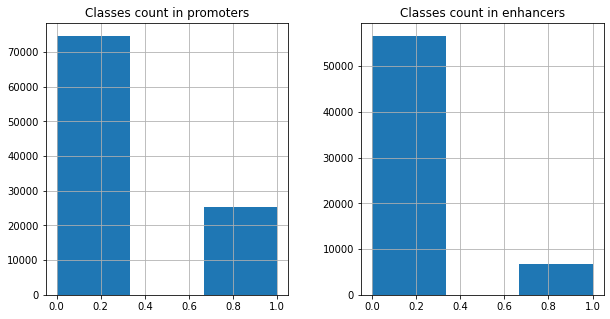

In [70]:
fig, axes = plt.subplots(ncols=2, figsize=(10, 5))


for axis, (region, y) in zip(axes.ravel(), labels.items()):
    y.hist(ax=axis, bins=3)
    axis.set_title(f"Classes count in {region}")
fig.show()



# **CORRELATION WITH OUTPUT**

The features which have no correlation with the output are not informative and they should be dropped. We evaluate the correlation with the output using Pearson coefficient, Spearman coefficient and Maximal information coefficient.
Since calculating MIC is computationally expensive, we compute it for only the features that result uncorrelated with the output according the two other tests.





In the models evaluation, we will find and drop the features non correlated with the output inside the training set for each holdout split.

In [13]:
def correlation_with_output(X,y,p_value_threshold:float = 0.01,mic_correlation_threshold:float = 0.05):
    uncorrelated= set()
    for  col  in tqdm(X,total=len(X.columns), desc="Running Pearson test ", dynamic_ncols=True, leave=True):
            correlation, p_value = pearsonr(X[col].values.flatten(), y.values.flatten())
            if p_value > p_value_threshold and np.abs(correlation)<0.95:
                uncorrelated.add(col)
                
    for  col in tqdm(X, total=len(X.columns), desc="Running Spearman test", dynamic_ncols=True, leave=True):
            correlation, p_value = spearmanr(X[col].values.flatten(), y.values.flatten())
            if p_value > p_value_threshold and np.abs(correlation)<0.95:
                uncorrelated.add(col)
    
    
    for column in tqdm(uncorrelated, desc="Running MINE test", dynamic_ncols=True, leave=True):
        mine = MINE()
        mine.compute_score(X[column].values.flatten(), y.values.flatten())
        score = mine.mic()
        if score < mic_correlation_threshold:
            print( column, score)
        else:
            uncorrelated.remove(column)
            
            
  
                
    return uncorrelated

In [14]:
def eliminate_features(dataset,features)-> pd.DataFrame:
    for i in features:
        dataset.drop(i, inplace=True, axis=1)
    return dataset

In [ ]:
uncorrelated_promoters = correlation_with_output(epigenomes['promoters'],labels['promoters'])
uncorrelated_enhancers = correlation_with_output(epigenomes['enhancers'],labels['enhancers'])

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF677 0.011312738265993084
AEBP2 0.0032041012876354424
ZNF34 0.003083406412818898
ZNF223 0.007727888432372584
ZNF549 0.006149690163012472
ZNF302 0.0032907213215631753


Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/25 [00:00<?, ?it/s]

ZNF768 0.0036295065581724373
ZNF155 0.0031461450068294484
ZNF549 0.003991403410234559
ZNF426 0.0032480552593097136
ZNF404 0.003373907083220939
ZNF211 0.004050956699405299
ZNF670 0.00303639985431252
ZNF292 0.0036517031431718226
ZNF530 0.003643736241529425
ZNF202 0.00425662257408253
ZNF140 0.0033764266116653014
ZNF416 0.0038474559029711072
ZNF23 0.002727898658396686
PRDM2 0.0024187617021504204
ZBTB49 0.003521018422181332
ZSCAN26 0.002810931856442111
ZNF791 0.004051864492147769
ZNF626 0.003927030620593264
ZNF677 0.004741447608694308
ZNF169 0.0038155777550659543
BCL6B 0.0059736457794703655
ZNF433 0.0037670256201843143
ZNF777 0.004653109243441651
ZNF157 0.0046015397283764815
ZNF19 0.003560270656996815


# **CORRELATION BETWEEN FEATURES**

If two features are highly correlated (correlation_score>0.95 and p_value<0.01), it means that they bring almost the same information. So, it is sufficient to keep only one and drop the other. To choose which feature we have to eliminate, we select the one with lower entropy. 

In the models evaluation, we will find and drop the features highly correlated  inside the training set for each holdout split.

In [15]:
def correlation_between_features(X,p_value_threshold:float = 0.01,correlation_threshold:float = 0.95):
    
    scores = []
    extremely_correlated= set()
    
    for i in range(0,len(X.columns)-1):
        for z in range(i+1,len(X.columns)):
            correlation,p_value=pearsonr(X[X.columns[i]].values,X[X.columns[z]].values)
            correlation=np.abs(correlation)
            scores.append((X.columns[i],X.columns[z],correlation))
            if p_value < p_value_threshold and correlation > correlation_threshold:
                #print( j.columns[i], j.columns[z], correlation)
                if entropy(X[X.columns[i]]) > entropy(X[X.columns[z]]):
                    extremely_correlated.add(x.columns[z])
                else:
                    extremely_correlated.add(x.columns[i])
                    
    
        
        
    return (scores,extremely_correlated)

In [ ]:
correlation_scores_promoters,extremely_correlated_promoters= correlation_between_features(epigenomes['promoters'])
correlation_scores_enhancers,extremely_correlated_enhancers= correlation_between_features(epigenomes['enhancers'])

scores={
    "promoters": correlation_scores_promoters,
    "enhancers": correlation_scores_enhancers
}

extremely_correlated={
    "promoters": extremely_correlated_promoters,
    "enhancers": extremely_correlated_enhancers
}


In [ ]:
extremely_correlated

{'enhancers': set(), 'promoters': set()}

In [ ]:
correlation_scores = {
    region:sorted(score, key=lambda x: np.abs(x[2]), reverse=True)
    for region, score in scores.items()
}

Most correlated features from promoters


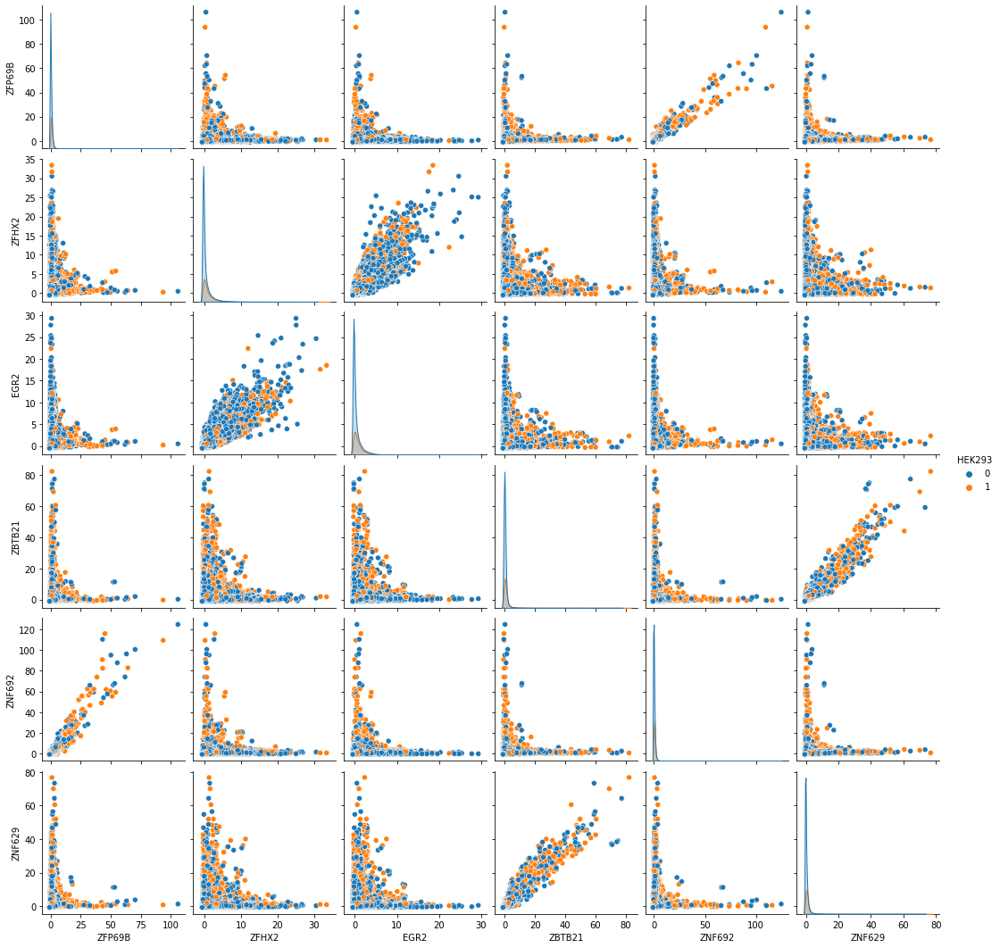

In [ ]:
firsts, seconds, _ = list(zip(*correlation_scores['promoters'][:3]))
columns = list(set(firsts+seconds))
print(f"Most correlated features from promoters")
sns.pairplot(pd.concat([
    epigenomes['promoters'][columns],
    labels['promoters'],
], axis=1), hue=labels['promoters'].columns[0])
plt.show()

Most correlated features from enhancers


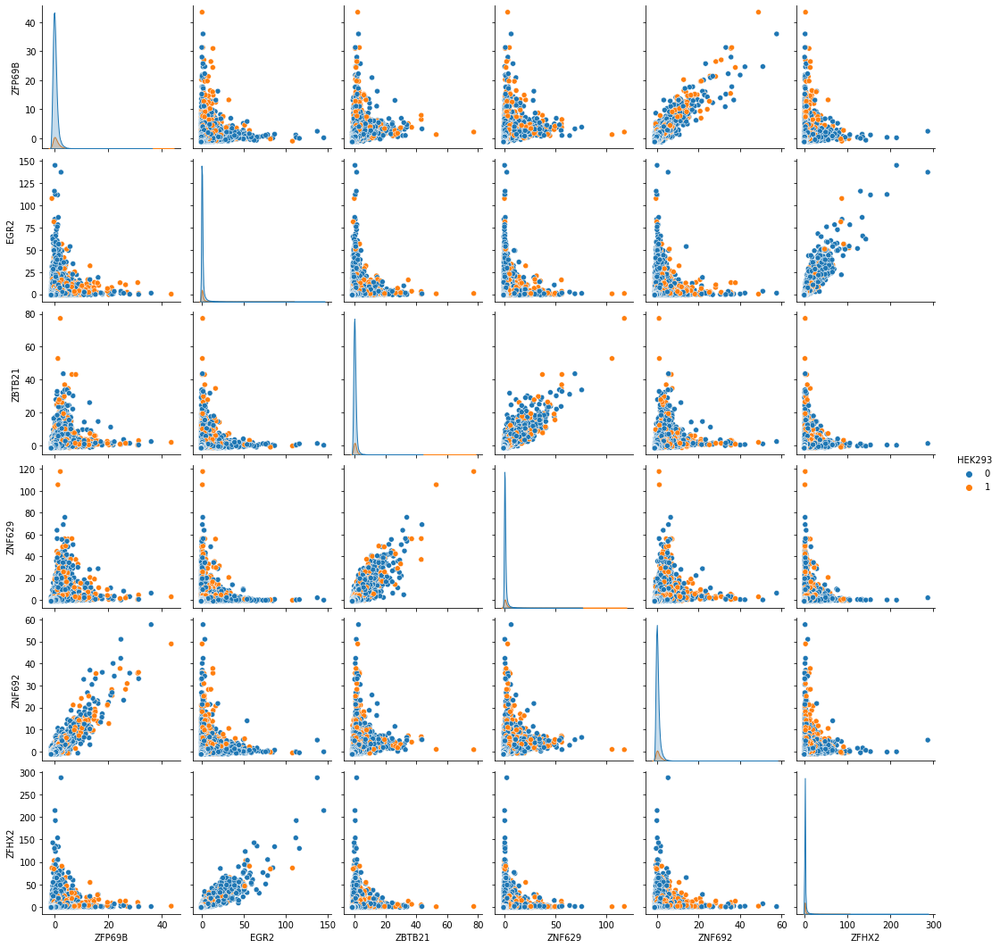

In [ ]:
firsts, seconds, _ = list(zip(*correlation_scores['enhancers'][:3]))
columns = list(set(firsts+seconds))
print(f"Most correlated features from enhancers")
sns.pairplot(pd.concat([
    epigenomes['enhancers'][columns],
    labels['enhancers'],
], axis=1), hue=labels['enhancers'].columns[0])
plt.show()

# **FEATURE DISTRIBUTIONS**

The following histograms show the distributions of the most different five features in the enhancers and promoters data.

In [ ]:
def get_top_most_different(dist, n:int):
    return np.argsort(
      -np.mean(dist, axis=1).flatten())[:n]

In [ ]:
from matplotlib.lines import Line2D
lines_legend = [Line2D([0], [0], color='red', lw=4),
                Line2D([0], [0], color='green', lw=4)]



def get_distributions(X,y,region,top_number = 8):
        dist = euclidean_distances(X.T)
        most_distance_columns_indices = get_top_most_different(dist, top_number)
        columns = X.columns[most_distance_columns_indices]
        fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(25, 5))
        print(f"Top {top_number} different features from {region}")
        for column, axis in zip(columns, axes.flatten()):
            head, tail = X[column].quantile([0.05, 0.95]).values.ravel()
        
            mask = ((X[column] < tail) & (X[column] > head)).values
            cleared_x = X[column][mask]
            cleared_y = y.values.ravel()[mask]
        
            cleared_x[cleared_y==0].hist(ax=axis, bins=20, color='red')
            cleared_x[cleared_y==1].hist(ax=axis, bins=20, color='green')

            axis.set_title(column)
        fig.legend(lines_legend, ['negative','positive'])
        fig.tight_layout()
        plt.show()

Top 8 different features from promoters


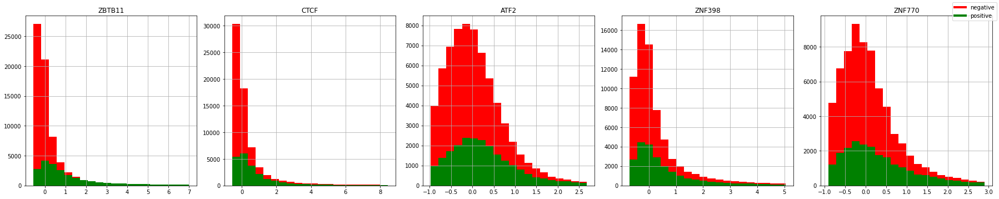

Top 8 different features from enhancers


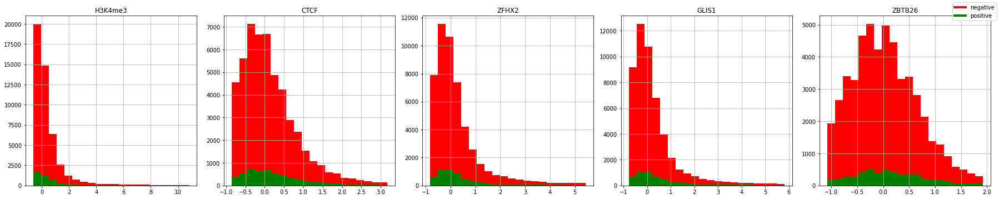

In [ ]:
for region in ['promoters','enhancers']:
    get_distributions(epigenomes[region],labels[region],region)

# **t-SNE feature visualization**

t-SNE is a technique of dimensionality reduction, which we will use for data visulaization, with the aim to identify patterns and clusters in datasets.
We will apply it on both sequence and epigenomic data

In [ ]:

def get_tsne_decomposition(
    X: pd.DataFrame,
    data_type: str,
    region: str,
    cell_line: str,
    metric: str,
)->pd.DataFrame:
    """Return the 2D TSNE decomposition of the given data."""
    # The import of the TSNECUDA is within the method and not
    # outside because it is hard to install the package
    from tsnecuda import TSNE
    return pd.DataFrame(
        TSNE(
            n_components=2,
            verbose=True
        ).fit_transform(X.values),
        index=X.index
    )

In [ ]:
from matplotlib.figure import Figure,Axes
def create_scatterplot(
    decomposition: pd.DataFrame,
    labels: np.ndarray,
    figure: Figure,
    ax: Axes
  ):
        plot = sns.scatterplot(x=decomposition.loc[:,0], y=decomposition.loc[:,1], hue=labels,
                     palette=sns.color_palette("hls", 2), ax=ax)
        
        

Metrics:   0%|          | 0/2 [00:00<?, ?it/s]

Task:   0%|          | 0/2 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


Task:   0%|          | 0/2 [00:00<?, ?it/s]

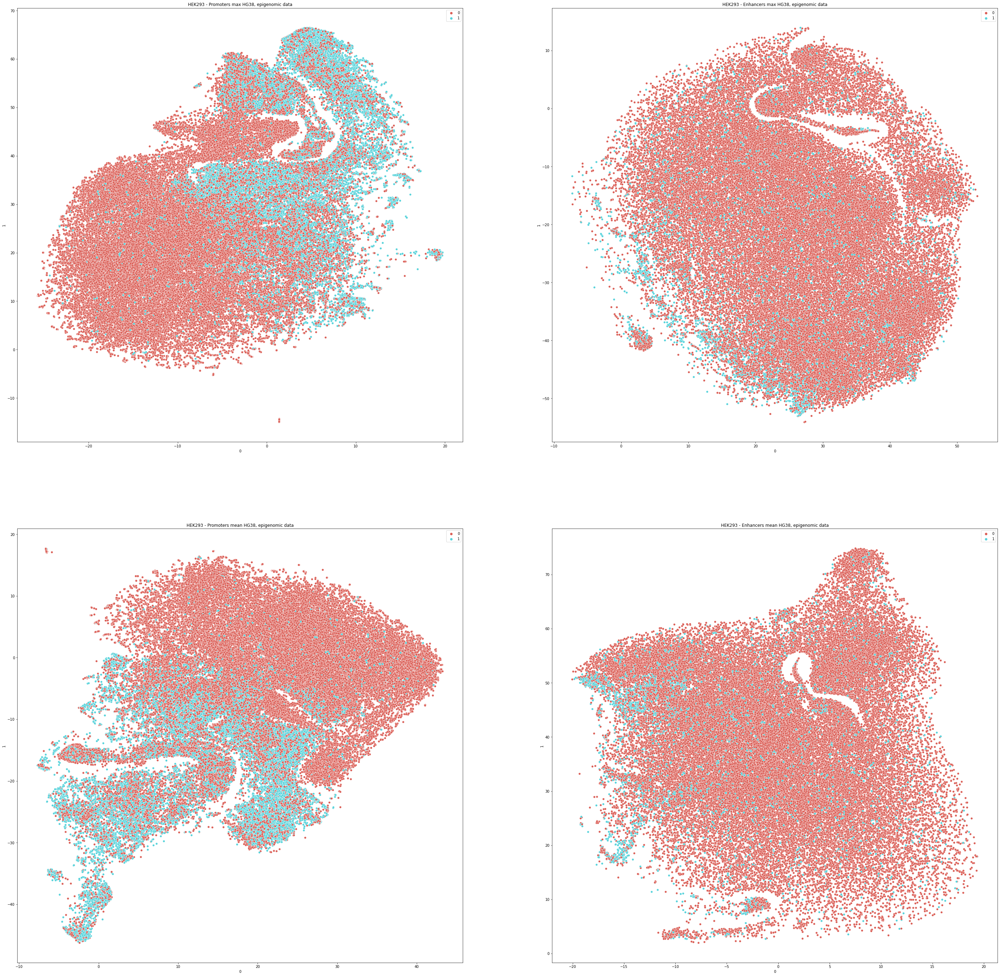

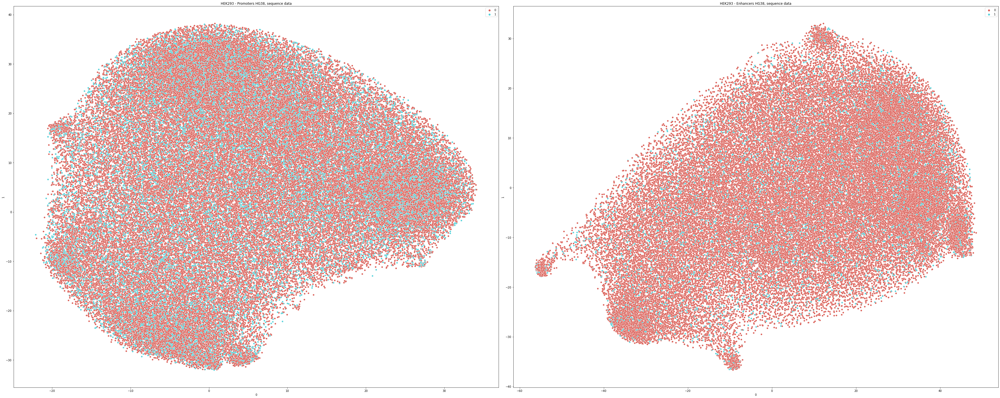

In [ ]:
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers, active_promoters_vs_inactive_promoters
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import KNNImputer
from keras_bed_sequence import BedSequence
from tsnecuda import TSNE

epigenomic_fig, epigenomic_axes = plt.subplots(
    nrows=2,
    ncols=2,
    figsize=(50,50),
    squeeze=False
)

sequence_fig, sequence_axes = plt.subplots(
    nrows=1,
    ncols=2,
    figsize=(50,20),
    squeeze=False
)

for k, metric in enumerate(tqdm(("max", "mean"), desc="Metrics", leave=False)):
          for j, ((epigenomic, labels), region) in enumerate(tqdm((
              (active_promoters_vs_inactive_promoters(binarize=True,metric=metric,cell_line=cell_line, window_size=256,min_active_tpm_value= 1,max_inactive_tpm_value=1), "Promoters"),
               (active_enhancers_vs_inactive_enhancers(binarize=True,metric=metric,cell_line=cell_line, window_size=256,min_active_tpm_value= 0, max_inactive_tpm_value=0),"Enhancers")
          ), desc="Task", leave=False)):
                imputed_epigenomic = pd.DataFrame(
                    MinMaxScaler().fit_transform(
                        KNNImputer().fit_transform(epigenomic)
                    ),
                    columns=epigenomic.columns,
                    index=epigenomic.index
                )
                decomposed_epigenomic = get_tsne_decomposition(
                    imputed_epigenomic,
                    "epigenomic",
                    region,
                    cell_line,
                    metric
                )
                create_scatterplot(
                    decomposition=decomposed_epigenomic,
                    labels=labels.values.astype(int).ravel(),
                    figure=epigenomic_fig,
                    ax=epigenomic_axes[k][j]
                )
                epigenomic_axes[k][j].set_title(f"{cell_line} - {region} {metric} HG38, epigenomic data")
                
                
                if k==0:
                    sequence = pd.DataFrame(
                        np.array(BedSequence(
                            genome,
                            bed=to_bed(labels),
                            batch_size=1
                        )).reshape(-1, 4*256),
                        index=labels.index
                    )
                    decomposed_sequence = get_tsne_decomposition(
                        sequence,
                        "sequence",
                        region,
                        cell_line,
                        metric="None",
                        
                    )
                    create_scatterplot(
                      decomposition=decomposed_sequence,
                      labels=labels.values.astype(int).ravel(),
                      figure=sequence_fig,
                      ax=sequence_axes[0][j]
                )
                    sequence_axes[0][j].set_title(f"{cell_line} - {region} HG38, sequence data")
                   
plt.tight_layout()
plt.show()
                    

# **FEATURE SELECTION**

The goal of feature selection  is to find the best set of features that allows building useful models. 

Boruta is a feature selection method that trains a random forest classifier  or regression and computes  a feature importance metric to evaluate the importance of each feature. 
Because of its computational expensiveness, we won't perform Boruta.


In [ ]:
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from boruta import BorutaPy
from multiprocessing import cpu_count

@Cache(
    cache_path=[
        "boruta/kept_features_{_hash}.json",
        "boruta/discarded_features_{_hash}.json"
    ],
    args_to_ignore=[
        "X_train", "y_train"
    ]
)
def execute_boruta_feature_selection(
    X_train: pd.DataFrame,
    y_train: np.ndarray,
    holdout_number: int,
    task_name: str,
    max_iter: int = 100
):
    """Returns tuple with list of kept features and list of discared features.
    
    Parameters
    --------------------------
    X_train: pd.DataFrame,
        The data reserved for the input of the training of the Boruta model.
    y_train: np.ndarray,
        The data reserved for the output of the training of the Boruta model.
    holdout_number: int,
        The current holdout number.
    regression: bool,
        Whether the task is a binary classification one (False) or a regression one (True).
    task_name: str,
        The name of the task.
    max_iter: int = 100,
        Number of iterations to run Boruta for.
    """
    # According to the requested task we build either a random forest regressor
    # or a random forest classifier.
    
    model = RandomForestClassifier(n_jobs=cpu_count(), class_weight='balanced_subsample', max_depth=5)
    
    # Create the Boruta model
    boruta_selector = BorutaPy(
        # Defining the model that Boruta should use.
        model,
        # We leave the number of estimators to be decided by Boruta
        n_estimators='auto',
        verbose=False,
        alpha=0.05, # p_value
        # In practice one would run at least 100-200 times,
        # until all tentative features are exausted.
        max_iter=max_iter, 
        random_state=42,
    )
    # Fit the Boruta model
    boruta_selector.fit(X_train, y_train)
    
    # Get the kept features and discarded features
    kept_features = list(X_train.columns[boruta_selector.support_])
    discarded_features = list(X_train.columns[~boruta_selector.support_])
    
    # Filter out the unused featured.
    return kept_features, discarded_features

# **MODEL EVALUATION**

Three kinds of Neural Networks will be built:

*   FFNN (Feed Forward Neural Network) for epigenomic data
*   CNN (Convolutional Neural Network) for sequence data
*  MMNN (Multimodal Neural Network) for epigenomic  data and sequence data


To make the datasets suitable to be used as input data by the models, we will use *KerasBedSequence* and *KerasMixedSequence*.

HOLDOUTS

Stratified holdout is a variation of simple hold-out,where each class is represented by the same percentage of samples in the training set and in the test set.

I adopted the method StratifiedShuffleSplit from the machine learning library Scikit-learn.
It creates a generator of indexes that we can apply to the dataset in order to split it into the training and test sets. The selected percentage of the test set is 30% and the chosen number of iteration is 2 because performing many iterations (i.e. 10) could be very computationally heavy.


In [16]:
from sklearn.model_selection import StratifiedShuffleSplit

# Here for speed sake we are only doing two holdouts
# but normally at least 10 are executed
number_of_splits = 2

holdouts_generator = StratifiedShuffleSplit(
    n_splits=number_of_splits,
    test_size=0.3
)



FFNN

To see if the usage of the mean as aggregation metric inside the epigenomic dataset produces a different model's performance compared to the max, we will apply FFNN on epigenomic dataset, considering both the metrics.

In [17]:
def get_ffnn_sequence(
    X: np.ndarray,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
    return MixedSequence(
        x={
            "epigenomic_data": VectorSequence(
                X,
                batch_size
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )



In [18]:
def train_model_ffnn(
    model: Model,
    model_name: str,
    task: str,
    metric: str,
    cell_line: str,
    training_sequence: MixedSequence,
    test_sequence: MixedSequence,
    holdout_number: int
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    
    history = pd.DataFrame(model.fit(
        train_sequence,
        validation_data=test_sequence,
        epochs=1000,
        verbose=False,
        callbacks=[
            EarlyStopping(
                "loss",
                min_delta=0.001,
                patience=2,
                mode="min"
            ),
           
        ]
    ).history)
    
    train_evaluation = dict(zip(model.metrics_names, model.evaluate(train_sequence, verbose=False)))
    test_evaluation = dict(zip(model.metrics_names, model.evaluate(test_sequence, verbose=False)))
    train_evaluation["run_type"] = "train"
    test_evaluation["run_type"] = "test"
    
    for evaluation in (train_evaluation, test_evaluation):
        evaluation["model_name"] = model_name
        evaluation["metric"] = metric
        evaluation["task"] = task
        evaluation["holdout_number"] = holdout_number
    
    evaluations = pd.DataFrame([
        train_evaluation,
        test_evaluation
    ])
    
    return history, evaluations

In [19]:
def build_ffnn(input_shape: int)->Tuple[Model,Layer,Layer]:
    
    input_epigenomic_data = Input(shape=(input_shape,), name="epigenomic_data")
    hidden_ffnn = Dense(80, activation="linear")(input_epigenomic_data)
    hidden_ffnn=BatchNormalization()(hidden_ffnn)
    hidden_ffnn= ReLU()(hidden_ffnn)
    hidden_ffnn = Dropout(rate=0.2)(hidden_ffnn)

    
    hidden_ffnn = Dense(60,activation="relu")(hidden_ffnn)
    hidden_ffnn = Dropout(rate=0.2)(hidden_ffnn)
    
    hidden_ffnn = Dense(40,activation="relu")(hidden_ffnn)
    hidden_ffnn = Dropout(rate=0.2)(hidden_ffnn)
    
    hidden_ffnn = Dense(20,activation="relu")(hidden_ffnn)
    hidden_ffnn = Dropout(rate=0.2)(hidden_ffnn)
    
   
    last_hidden_ffnn = hidden_ffnn
    output_ffnn = Dense(1, activation="sigmoid")(hidden_ffnn)
    
    ffnn = Model(
        inputs=input_epigenomic_data,
        outputs=output_ffnn,
        name="FFNN"
    )

    ffnn.compile(
        optimizer="nadam",
        loss="binary_crossentropy",
        metrics=get_complete_binary_metrics()
    )
    return ffnn, input_epigenomic_data, last_hidden_ffnn

In [20]:
from tqdm.auto import tqdm
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers, active_promoters_vs_inactive_promoters
from epigenomic_dataset.utils import normalize_epigenomic_data

# Create a list to store all the computed performance
ffnn_performance = []

ffnn_training_histories = {}



for metric in tqdm(['mean','max'],desc="Metric"):
    ffnn_training_histories[metric]= {}
    for task, threshold in tqdm((
        (active_enhancers_vs_inactive_enhancers, 0),
        (active_promoters_vs_inactive_promoters, 1),

    ), desc="Tasks"):
        task_name = task.__name__
        # We get the task data with binarized labels
        X, y = task(
        binarize=True,
        cell_line=cell_line,
        window_size=window_size,
        min_active_tpm_value=threshold,
        max_inactive_tpm_value=threshold,
        metric=metric
        )
        ffnn_training_histories[metric][task_name]= []
        # Extract the bed coordinates from the epigenomic dataset
       

        # Start the main loop, iterating through the holdouts
        for holdout_number, (train_indices, test_indices) in tqdm(
            enumerate(holdouts_generator.split(X, y)),
            total=number_of_splits,
            leave=False,
            desc="Computing holdouts"
        ):
            # Get the training and test data
            train_X, test_X = X.iloc[train_indices], X.iloc[test_indices]
            train_y, test_y = y.iloc[train_indices], y.iloc[test_indices]
            # Impute and normalize the epigenomic data
            train_X = robust_zscoring(knn_imputation(train_X))
            test_X= robust_zscoring(knn_imputation(test_X))
            #find features of the training set which are uncorrelated with the output
            uncorrelated=correlation_with_output(train_X,train_y)
            #eliminate the uncorrelated features
            train_X=eliminate_features(train_X,uncorrelated)
            #find the highly correlated features
            scores,features_correlated=correlation_between_features(train_X)
            #eliminate the extremely correlated features
            train_X=eliminate_features(train_X,features_correlated)
            #drop all the features eliminated in the training set
            test_X= eliminate_features(test_X,uncorrelated)
            test_X= eliminate_features(test_X,features_correlated)
            train_X = train_X.to_numpy()
            test_X=test_X.to_numpy()
        
            # Get the number of features of this specific dataset
            number_of_features = train_X.shape[1]
        
        
            # Flatten the output values
            train_y = train_y.values.flatten()
            test_y = test_y.values.flatten()
        
     
            ffnn, input_epigenomic_data, last_hidden_ffnn = build_ffnn(number_of_features)
            
            for model, train_sequence, test_sequence in tqdm(
                (
                
                (ffnn, get_ffnn_sequence(train_X, train_y), get_ffnn_sequence(test_X, test_y)),
                
                ),
                desc="Training models",
                leave=False
            ):
            
            # We compute the model performance
                history, performance = train_model_ffnn(
                    model,
                    model.name,
                    task_name,
                    metric,
                    cell_line,
                    train_sequence,
                    test_sequence,
                    holdout_number
                )
                ffnn_training_histories[metric][task_name].append(history)
                # We chain the computed performance to the performance list
                ffnn_performance.append(performance)
                
        
# We convert the computed performance list into a DataFrame
ffnn_performance = pd.concat(ffnn_performance)


Metric:   0%|          | 0/2 [00:00<?, ?it/s]

Tasks:   0%|          | 0/2 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/26 [00:00<?, ?it/s]

ZNF677 0.00593951907526791
ZNF155 0.004414506240173124
BCL6B 0.007121775432026456
ZNF791 0.005152247735887746
ZNF416 0.005685929065580917
ZNF777 0.006273216179399697
ZNF404 0.004453010639212522
ZNF433 0.004974917074555683
ZNF768 0.00487623934051913
ZNF266 0.00553505269804342
ZBTB49 0.005043410690883899
ZNF138 0.00448004877841251
ZNF549 0.005784487952577227
PRDM2 0.0034676507884902614
ZNF626 0.004666675584607866
ZNF548 0.0050601670990014155
ZNF211 0.005762492451749651
ZNF426 0.004300861601185621
ZNF214 0.003988188681126739
ZNF19 0.004658519664738401
ZNF169 0.005105269437672423
ZNF530 0.0048545526288218625
ZNF157 0.004954056826475596
ZNF23 0.0036048618074081386
ZNF292 0.0053446252586705585
ZNF202 0.005505335623283065


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/24 [00:00<?, ?it/s]

ZNF677 0.005947939477192871
ZNF155 0.004483181980924058
BCL6B 0.0076587528340110525
ZNF791 0.00614476643761635
ZNF777 0.005407817831727216
ZNF404 0.00520769955385651
ZNF433 0.005223212422465081
ZNF768 0.004608274336542787
ZBTB49 0.004934871805619888
ZNF549 0.005222656523541452
ZNF140 0.005345543666478417
PRDM2 0.0034489814201528945
ZNF626 0.005127876140902921
ZNF548 0.005299233688595072
ZNF211 0.005348646708873265
ZNF426 0.004387458688810978
ZNF214 0.0037215999591586027
ZNF19 0.00478451746790221
ZNF169 0.00508319567282619
ZNF530 0.004903441927891064
ZNF157 0.005707757104746808
ZNF23 0.00359153019904788
ZNF292 0.004878091976981092
ZNF202 0.005698818082825381


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF677 0.012849995260057524
ZNF704 0.009463019863964866
ZNF223 0.00915199206079235
ZNF34 0.0042870392028920845
ZNF549 0.007343725333226647
ZNF302 0.004436669452110885


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF677 0.012089627022271876
AEBP2 0.0038011081120187806
ZNF223 0.009223548073663103
ZNF34 0.0037797603849210543
ZNF549 0.006948265544984139
ZNF302 0.004066884698990321


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Tasks:   0%|          | 0/2 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/31 [00:00<?, ?it/s]

ZNF677 0.006219980273912159
ZNF155 0.004388532065328316
BCL6B 0.00740851091917066
ZNF791 0.0052686217251019735
ZNF416 0.0049920709324066575
ZNF777 0.006062935933910924
ZNF404 0.004811879436860681
ZNF433 0.005039236943174209
ZNF768 0.004254037612938764
ZNF266 0.005004860084295033
ZBTB49 0.005176438467208967
ZNF138 0.00422677181609043
ZNF549 0.005429191642381843
ZNF140 0.0042428217193530285
PRDM2 0.0034009327983637754
ZNF626 0.004984312397483913
ZNF670 0.004547348025240645
ZNF548 0.0061008015557080875
ZNF211 0.005677537362693751
ZNF426 0.004681194522088995
ZNF704 0.004442236077441104
ZNF214 0.0040545143831563655
ZNF19 0.004867045275460984
ZNF169 0.0051418597004633275
ZNF530 0.0043317700543787805
ZNF701 0.004653032895089582
ZNF157 0.005933292272540099
ZNF23 0.0037086755366751416
ZNF680 0.005474542117869594
ZNF292 0.004686809188366393
ZNF202 0.005640242512565376


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/28 [00:00<?, ?it/s]

ZNF677 0.006495663754504999
ZNF155 0.004498950036963291
BCL6B 0.007193748673013558
ZNF791 0.004721738660818105
ZNF416 0.0053244885423126
ZNF777 0.006166068879230643
ZNF404 0.004516407643011084
ZNF433 0.004662463179047345
ZNF768 0.004712866211031102
ZBTB49 0.0042919505053862095
ZNF549 0.004698474187761162
ZNF140 0.0043569264655967995
PRDM2 0.00341387790743718
ZNF626 0.004975086154990308
ZSCAN26 0.003671200104235788
ZNF670 0.004112688743036867
ZNF211 0.005401407373824697
ZNF426 0.004069467186005666
ZNF704 0.00477889143712372
ZNF214 0.004236158836646855
ZNF19 0.00461384161879167
ZNF169 0.005152106841761122
ZNF530 0.004932630442843362
ZNF157 0.005343371040065415
ZNF23 0.003788372171958231
ZNF680 0.005606834913419803
ZNF292 0.005234836916419888
ZNF202 0.005425793935376077


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/7 [00:00<?, ?it/s]

ZNF677 0.012579476814201828
AEBP2 0.0036319605890893347
ZNF223 0.00969900446279408
ZNF34 0.004017698124602812
ZNF549 0.007374797343122603
ZNF302 0.004439782379142227
ZNF585B 0.005343820293035296


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/7 [00:00<?, ?it/s]

ZNF677 0.012451423161367514
AEBP2 0.0043863592980508005
ZNF223 0.00892571623959839
ZNF34 0.003980370868964941
ZNF549 0.006893413079692431
ZNF302 0.004003856982093767
ZNF585B 0.006007757884360695


Training models:   0%|          | 0/1 [00:00<?, ?it/s]

CNN

In [35]:
def get_cnn_sequence(
    genome: Genome,
    bed: pd.DataFrame,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
    
    return MixedSequence(
        x={
            "sequence_data": BedSequence(
                genome,
                bed,
                batch_size=batch_size,
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )

In [34]:
def build_cnn(window_size: int)-> Tuple[Model,Layer,Layer]:
    input_sequence_data = Input(shape=(window_size, 4), name="sequence_data")
    hidden_cnn = Conv1D(24, kernel_size=4, activation="relu", )(input_sequence_data)
    hidden_cnn = Dropout(rate=0.2)(hidden_cnn)
    hidden_cnn = MaxPool1D(pool_size=2, strides=2)(hidden_cnn)

    hidden_cnn = Conv1D(filters=48,kernel_size=6,activation="relu")(hidden_cnn)
    hidden_cnn = Dropout(rate=0.2)(hidden_cnn)
    hidden_cnn = MaxPool1D(pool_size=2, strides=2)(hidden_cnn)

    hidden_cnn = Conv1D(filters=72,kernel_size=8,activation="relu")(hidden_cnn)
    hidden_cnn = Dropout(rate=0.2)(hidden_cnn)
    hidden_cnn = MaxPool1D(pool_size=2, strides=2)(hidden_cnn)
    
    hidden_cnn = Conv1D(filters=96,kernel_size=10,activation="relu")(hidden_cnn)
    hidden_cnn = Dropout(rate=0.2)(hidden_cnn)
    hidden_cnn = MaxPool1D(pool_size=2, strides=2)(hidden_cnn)

    
       
    hidden_cnn = Flatten()(hidden_cnn)
    hidden_cnn = Dense(64, activation="relu")(hidden_cnn)
    hidden_cnn= Dropout(rate=0.3)(hidden_cnn)
    hidden_cnn = Dense(32, activation="relu")(hidden_cnn)
    hidden_cnn= Dropout(rate=0.3)(hidden_cnn)
    hidden_cnn = Dense(16, activation="relu")(hidden_cnn)
    hidden_cnn= Dropout(rate=0.3)(hidden_cnn)
    last_hidden_cnn = hidden_cnn
    output_cnn = Dense(1, activation="sigmoid")(last_hidden_cnn)
    
    
    cnn = Model(
        inputs=input_sequence_data,
        outputs=output_cnn,
        name="CNN"
    )

    cnn.compile(
        optimizer="nadam",
        loss="binary_crossentropy",
        metrics=get_complete_binary_metrics()
    )
    return cnn, input_sequence_data, last_hidden_cnn

MMNN

In [30]:
def get_mmnn_sequence(
    genome: Genome,
    bed: pd.DataFrame,
    X: np.ndarray,
    y: np.ndarray,
    batch_size: int = 1024
) -> MixedSequence:
   
    return MixedSequence(
        x={
            "sequence_data": BedSequence(
                genome,
                bed,
                batch_size=batch_size,
            ),
            "epigenomic_data": VectorSequence(
                X,
                batch_size
            )
        },
        y=VectorSequence(
            y,
            batch_size=batch_size
        )
    )


In [31]:
def build_mmnn(
    input_epigenomic_data: Layer = None,
    input_sequence_data: Layer = None,
    last_hidden_ffnn: Layer = None,
    last_hidden_cnn: Layer = None,
):

    
        
    
    concatenation_layer = Concatenate()([
        last_hidden_ffnn,
        last_hidden_cnn
    ])
    hidden_mmnn= Dense(80, activation="relu")(concatenation_layer)
    hidden_mmnn=Dropout(rate=0.3)(hidden_mmnn)
    hidden_mmnn= Dense(60, activation="relu")(hidden_mmnn)
    hidden_mmnn=Dropout(rate=0.3)(hidden_mmnn)
    hidden_mmnn= Dense(40, activation="relu")(concatenation_layer)
    hidden_mmnn=Dropout(rate=0.3)(hidden_mmnn)
    hidden_mmnn= Dense(20, activation="relu")(hidden_mmnn)
    hidden_mmnn=Dropout(rate=0.3)(hidden_mmnn)
    last_hidden_mmnn = hidden_mmnn
    output_mmnn = Dense(1, activation="sigmoid")(last_hidden_mmnn)

    mmnn = Model(
        inputs=[input_epigenomic_data, input_sequence_data],
        outputs=output_mmnn,
        name="MMNN"
    )

    mmnn.compile(
        optimizer="nadam",
        loss="binary_crossentropy",
        metrics=get_complete_binary_metrics()
    )

    return mmnn

In [32]:

def train_model(
    model: Model,
    model_name: str,
    task: str,
    cell_line: str,
    training_sequence: MixedSequence,
    test_sequence: MixedSequence,
    holdout_number: int
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    
    history = pd.DataFrame(model.fit(
        train_sequence,
        validation_data=test_sequence,
        epochs=1000,
        verbose=False,
        callbacks=[
            EarlyStopping(
                "loss",
                min_delta=0.001,
                patience=2,
                mode="min"
            ),
           
        ]
    ).history)
    
    train_evaluation = dict(zip(model.metrics_names, model.evaluate(train_sequence, verbose=False)))
    test_evaluation = dict(zip(model.metrics_names, model.evaluate(test_sequence, verbose=False)))
    train_evaluation["run_type"] = "train"
    test_evaluation["run_type"] = "test"
    
    for evaluation in (train_evaluation, test_evaluation):
        evaluation["model_name"] = model_name
        evaluation["task"] = task
        evaluation["holdout_number"] = holdout_number
    
    evaluations = pd.DataFrame([
        train_evaluation,
        test_evaluation
    ])
    
    return history, evaluations

In [36]:
from tqdm.auto import tqdm
from epigenomic_dataset import active_enhancers_vs_inactive_enhancers, active_promoters_vs_inactive_promoters
from epigenomic_dataset.utils import normalize_epigenomic_data

# Create a list to store all the computed performance
all_performance = []

training_histories = {}


# For each task
for task, threshold in tqdm((
    (active_enhancers_vs_inactive_enhancers, 0),
    (active_promoters_vs_inactive_promoters, 1),

), desc="Tasks"):
    task_name = task.__name__
    # We get the task data with binarized labels
    X, y = task(
        binarize=True,
        cell_line=cell_line,
        window_size=window_size,
        min_active_tpm_value=threshold,
        max_inactive_tpm_value=threshold
    )
    training_histories[task_name] = []
    # Extract the bed coordinates from the epigenomic dataset
    bed = to_bed(X)

    # Start the main loop, iterating through the holdouts
    for holdout_number, (train_indices, test_indices) in tqdm(
        enumerate(holdouts_generator.split(X, y)),
        total=number_of_splits,
        leave=False,
        desc="Computing holdouts"
    ):
        # Get the training and test data
        train_bed, test_bed = bed.iloc[train_indices], bed.iloc[test_indices]
        train_X, test_X = X.iloc[train_indices], X.iloc[test_indices]
        train_y, test_y = y.iloc[train_indices], y.iloc[test_indices]
        # Impute and normalize the epigenomic data
        train_X = robust_zscoring(knn_imputation(train_X))
        test_X= robust_zscoring(knn_imputation(test_X))
        #find features of the training set which are uncorrelated with the output
        uncorrelated=correlation_with_output(train_X,train_y)
        #eliminate the uncorrelated features
        train_X=eliminate_features(train_X,uncorrelated)
        #find the highly correlated features
        scores,features_correlated=correlation_between_features(train_X)
        #eliminate the extremely correlated features
        train_X=eliminate_features(train_X,features_correlated)
        #drop all the features eliminated in the training set
        test_X= eliminate_features(test_X,uncorrelated)
        test_X= eliminate_features(test_X,features_correlated)
        train_X = train_X.to_numpy()
        test_X=test_X.to_numpy()
        
        # Get the number of features of this specific dataset
        number_of_features = train_X.shape[1]
        
        
        # Flatten the output values
        train_y = train_y.values.flatten()
        test_y = test_y.values.flatten()
        
     
        ffnn, input_epigenomic_data, last_hidden_ffnn = build_ffnn(number_of_features)
        cnn, input_sequence_data, last_hidden_cnn = build_cnn(window_size)
        mmnn = build_mmnn(
            input_sequence_data=input_sequence_data,
            input_epigenomic_data=input_epigenomic_data,
            last_hidden_ffnn=last_hidden_ffnn,
            last_hidden_cnn=last_hidden_cnn
        )
        for model, train_sequence, test_sequence in tqdm(
            (
                
                (ffnn, get_ffnn_sequence(train_X, train_y), get_ffnn_sequence(test_X, test_y)),
                (cnn, get_cnn_sequence(genome, train_bed, train_y), get_cnn_sequence(genome, test_bed, test_y)),
                (mmnn, get_mmnn_sequence(genome, train_bed, train_X, train_y), get_mmnn_sequence(genome, test_bed, test_X, test_y)),
                
            ),
            desc="Training models",
            leave=False
        ):
            #I skipped Boruta because it is computationally expensive
            history, performance = train_model(
                model,
                model.name,
                task_name,
                cell_line,
                train_sequence,
                test_sequence,
                holdout_number
            )
            training_histories[task_name].append(history)
            # We chain the computed performance to the performance list
            all_performance.append(performance)
            
        
# We convert the computed performance list into a DataFrame
all_performance = pd.concat(all_performance)


Tasks:   0%|          | 0/2 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/23 [00:00<?, ?it/s]

ZNF677 0.0055798643280820116
ZNF155 0.004474501591020711
BCL6B 0.008042149329159799
ZNF791 0.005214395535072156
ZNF416 0.00551629192572072
ZNF777 0.006692906315849998
ZNF433 0.004801902428005607
ZNF768 0.005192004567160877
ZBTB49 0.004665479103363946
ZNF549 0.005057211383323969
ZNF140 0.00485916002166335
ZNF670 0.00465559310846902
ZNF626 0.005306248266221016
ZSCAN26 0.003881597653542997
PRDM2 0.003389242782766188
ZNF211 0.005374294981222435
ZNF426 0.00421535495135746
ZNF19 0.00453137226927803
ZNF169 0.005614430860006994
ZNF530 0.004983408919837589
ZNF23 0.004170927067260643
ZNF292 0.004800244669696707
ZNF202 0.005675656403640176


Training models:   0%|          | 0/3 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/30 [00:00<?, ?it/s]

ZNF677 0.005756422539273391
ZNF155 0.004359839189899797
BCL6B 0.007304744975560408
ZNF791 0.004927572037208741
ZNF416 0.004931476428950016
ZNF777 0.005849769586639186
ZNF404 0.0045176850254179685
ZNF433 0.005041654425984136
ZNF768 0.00488020750232355
ZFP41 0.0037878449919236308
ZBTB49 0.00456249819534256
ZNF138 0.004634187553166099
ZNF549 0.00534932799278629
ZNF140 0.0041684125243718955
PRDM2 0.0031559908547535253
ZNF670 0.0039466224361576815
ZSCAN26 0.004168009592427261
ZNF548 0.005350006178218184
ZNF211 0.0053600266307169105
ZNF426 0.004354590948310397
ZNF704 0.004537202881335685
ZNF214 0.003957439500471875
ZNF19 0.004719581874496893
ZNF169 0.005446021365732693
ZNF530 0.004526976812463338
ZNF157 0.0060038849094175934
ZNF23 0.004040467504787654
ZNF680 0.005097276456372657
ZNF292 0.004789748013169047
ZNF202 0.005791078016472658


Training models:   0%|          | 0/3 [00:00<?, ?it/s]

Computing holdouts:   0%|          | 0/2 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF677 0.01278017108717138
AEBP2 0.0037046680660050616
ZNF223 0.009100150897942874
ZNF34 0.003482637899353806
ZNF549 0.007547486474639645
ZNF302 0.0041941415764060125


Training models:   0%|          | 0/3 [00:00<?, ?it/s]

Running Pearson test :   0%|          | 0/196 [00:00<?, ?it/s]

Running Spearman test:   0%|          | 0/196 [00:00<?, ?it/s]

Running MINE test:   0%|          | 0/6 [00:00<?, ?it/s]

ZNF677 0.01260953037183819
AEBP2 0.0038375821128712024
ZNF223 0.009204199089066176
ZNF34 0.003961776816705405
ZNF549 0.00696980057398645
ZNF302 0.00458582146135639


Training models:   0%|          | 0/3 [00:00<?, ?it/s]

# **RESULTS**

In this last part, we use the *barplots* and *plot_keras_history* packages to visualize the results of the executed models.

Also we perform Wilconxon test to check if the models, considering their performance, are statistically indistinguishable.

FFNN-  MODEL'S PERFORMANCE WITH MEAN OR MAX AS AGGREGATION METRICS IN THE EPIGENOMIC DATA

In [21]:
ffnn_performance


,loss,accuracy,recall,precision,AUROC,AUPRC,f1_score,balanced_accuracy,specificity,miss_rate,...,informedness,markedness,positive_likelyhood_ratio,negative_likelyhood_ratio,DOR,run_type,model_name,metric,task,holdout_number
0,0.290480,0.901014,0.118039,0.659856,0.745292,0.349007,0.200255,0.555451,0.992862,0.881961,...,0.279086,0.565485,16.536926,0.888301,1.249469,train,FFNN,mean,active_enhancers_vs_inactive_enhancers,0
1,0.302641,0.900716,0.110888,0.661677,0.694889,0.310597,0.189944,0.552119,0.993350,0.889112,...,0.270873,0.566673,16.675161,0.895064,1.232736,test,FFNN,mean,active_enhancers_vs_inactive_enhancers,0
0,0.288197,0.902458,0.122124,0.704715,0.760671,0.361790,0.208173,0.558061,0.993997,0.877876,...,0.293365,0.610837,20.344130,0.883177,1.262754,train,FFNN,mean,active_enhancers_vs_inactive_enhancers,1
1,0.306197,0.898873,0.103362,0.607670,0.685613,0.298708,0.176672,0.547768,0.992173,0.896638,...,0.250619,0.511836,13.206046,0.903711,1.211252,test,FFNN,mean,active_enhancers_vs_inactive_enhancers,1
0,0.298370,0.861720,0.772496,0.707768,0.926834,0.783921,0.738717,0.832221,0.891946,0.227504,...,0.739424,0.628232,7.149176,0.255065,4.960225,train,FFNN,mean,active_promoters_vs_inactive_promoters,0
1,0.353305,0.834741,0.713136,0.660679,0.890921,0.696857,0.685906,0.794535,0.875933,0.286864,...,0.686407,0.560822,5.747972,0.327495,3.866996,test,FFNN,mean,active_promoters_vs_inactive_promoters,0
0,0.313740,0.855970,0.735813,0.706962,0.917278,0.757415,0.721099,0.816244,0.896676,0.264187,...,0.721243,0.616208,7.121396,0.294630,4.442008,train,FFNN,mean,active_promoters_vs_inactive_promoters,1
1,0.356609,0.831403,0.685703,0.660778,0.888304,0.692477,0.673010,0.783230,0.880758,0.314297,...,0.673125,0.552935,5.750497,0.356848,3.613191,test,FFNN,mean,active_promoters_vs_inactive_promoters,1
0,0.290643,0.902255,0.115029,0.714286,0.746862,0.352603,0.198148,0.554816,0.994603,0.884971,...,0.286642,0.619774,21.311152,0.889773,1.246261,train,FFNN,max,active_enhancers_vs_inactive_enhancers,0
1,0.306074,0.900137,0.099849,0.661130,0.682382,0.298730,0.173496,0.546924,0.993998,0.900151,...,0.256931,0.565117,16.634447,0.905586,1.207133,test,FFNN,max,active_enhancers_vs_inactive_enhancers,0


Rendering barplots:   0%|          | 0/27 [00:00<?, ?it/s]

[(<Figure size 3200x300 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe2a5d1c1d0>,
        dtype=object)),
 (<Figure size 3200x300 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe2a5862b90>,
        dtype=object)),
 (<Figure size 3200x300 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe2a5678450>,
        dtype=object)),
 (<Figure size 3200x300 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe2a5836390>,
        dtype=object)),
 (<Figure size 3200x300 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe2a5342110>,
        dtype=object)),
 (<Figure size 3200x300 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe2a51dc890>,
        dtype=object)),
 (<Figure size 3200x300 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe2a4e5f550>,
        dtype=object)),
 (<Figure size 3200x300 with 2 Axes>,
  a

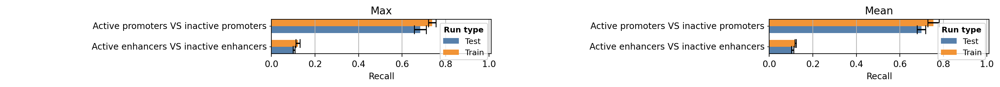

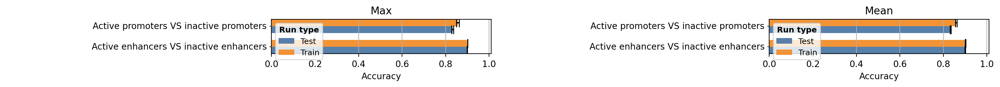

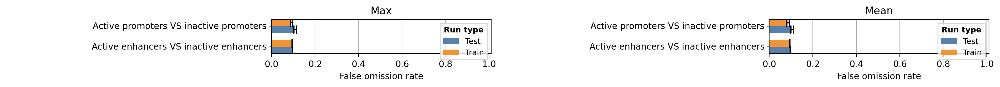

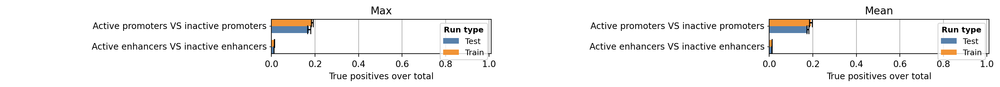

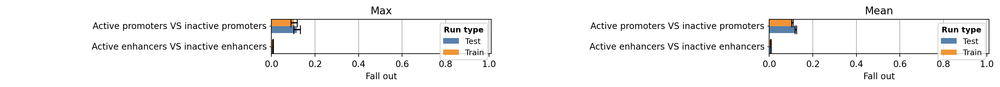

...

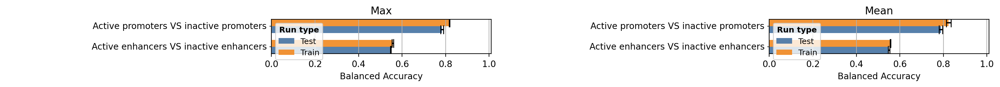

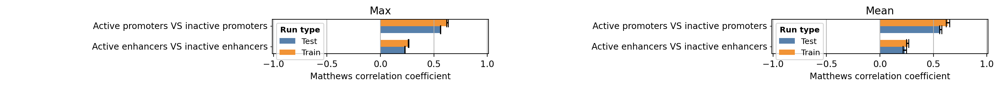

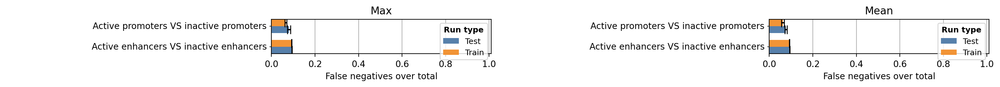

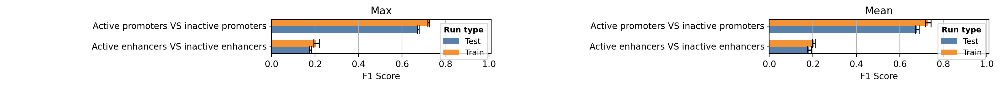

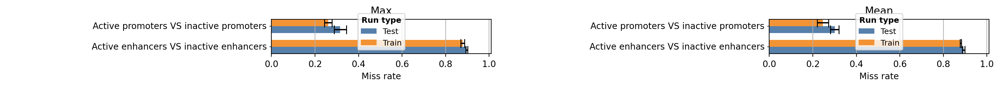

In [28]:
from barplots import barplots

barplots(
   ffnn_performance.drop(columns=["holdout_number"]),
    groupby=["metric", "task", "run_type",],
    orientation="horizontal",
    height=8,
    subplots=True,
)

WILCOXON TEST

In [29]:
for task in ffnn_performance.task.unique():
    print("*"*80)
    print(task)
    print("*"*80)
    model_A = ffnn_performance.metric.unique()[0]
    model_A_performance =ffnn_performance[(ffnn_performance.metric=='mean') & (ffnn_performance.run_type=="test")&(ffnn_performance.task==task)]
    model_B=ffnn_performance.metric.unique()[1]
    model_B_performance =ffnn_performance[(ffnn_performance.metric=='max') & (ffnn_performance.run_type=="test")&(ffnn_performance.task==task)]
    for met in ('AUROC','AUPRC','accuracy'):
        _, p_value=wilcoxon(model_A_performance[met],model_B_performance[met])
        if p_value <0.05 :
            if model_A_performance[met].mean()> model_B_performance[met].mean():
                best_model,worse_model=model_A,model_B
            else:
                best_model,worse_model=model_B,model_A
                print(f"The metric {model_A} outperforms the metric {worse_model} with p_value {p_value} on metric {metric} ")
        else:
             print(f"The metric {model_A} is statistically indistinguishable from {model_B} with p_value {p_value} on metric {met}")
  

********************************************************************************
active_enhancers_vs_inactive_enhancers
********************************************************************************
The metric mean is statistically indistinguishable from max with p_value 0.6547208460185769 on metric AUROC
The metric mean is statistically indistinguishable from max with p_value 0.17971249487899976 on metric AUPRC
The metric mean is statistically indistinguishable from max with p_value 0.6547208460185769 on metric accuracy
********************************************************************************
active_promoters_vs_inactive_promoters
********************************************************************************
The metric mean is statistically indistinguishable from max with p_value 0.17971249487899976 on metric AUROC
The metric mean is statistically indistinguishable from max with p_value 0.17971249487899976 on metric AUPRC
The metric mean is statistically indistinguishable f

ALL RESULTS

In [37]:
all_performance

,loss,accuracy,recall,precision,AUROC,AUPRC,f1_score,balanced_accuracy,specificity,miss_rate,...,fowlkes_mallows_index,informedness,markedness,positive_likelyhood_ratio,negative_likelyhood_ratio,DOR,run_type,model_name,task,holdout_number
0,0.222174,0.905912,0.172221,0.715818,0.909119,0.566608,0.277643,0.582100,0.991979,0.827779,...,0.582100,0.351111,0.626656,21.472122,0.834472,1.392918,train,FFNN,active_enhancers_vs_inactive_enhancers,0
1,0.335207,0.898241,0.126944,0.568539,0.650828,0.273204,0.207547,0.557823,0.988701,0.873056,...,0.557823,0.268650,0.474693,11.235133,0.883033,1.261536,test,FFNN,active_enhancers_vs_inactive_enhancers,0
0,0.338253,0.895032,0.000215,1.000000,0.617907,0.188153,0.000430,0.500108,1.000000,0.999785,...,0.500108,0.014663,0.895029,2150.075195,0.999785,1.000430,train,CNN,active_enhancers_vs_inactive_enhancers,0
1,0.340297,0.895028,0.000000,0.000000,0.592478,0.169123,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104972,0.000000,1.000000,1.000000,test,CNN,active_enhancers_vs_inactive_enhancers,0
0,0.168564,0.933091,0.445496,0.843305,0.961256,0.762557,0.583005,0.717893,0.990290,0.554504,...,0.717893,0.612934,0.781668,45.877480,0.559942,2.544749,train,MMNN,active_enhancers_vs_inactive_enhancers,0
1,0.394775,0.886653,0.135474,0.386266,0.634224,0.239722,0.200594,0.555114,0.974754,0.864526,...,0.555114,0.228755,0.292046,5.366208,0.886917,1.247768,test,MMNN,active_enhancers_vs_inactive_enhancers,0
0,0.281646,0.902774,0.112234,0.745714,0.778419,0.386367,0.195104,0.553872,0.995511,0.887766,...,0.553872,0.289300,0.651010,24.998606,0.891770,1.241510,train,FFNN,active_enhancers_vs_inactive_enhancers,1
1,0.307301,0.899189,0.094330,0.632997,0.684517,0.289847,0.164192,0.543958,0.993586,0.905670,...,0.543958,0.244358,0.536416,14.705755,0.911517,1.192780,test,FFNN,active_enhancers_vs_inactive_enhancers,1
0,0.322852,0.895009,0.000000,0.000000,0.655910,0.211256,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104991,0.000000,1.000000,1.000000,train,CNN,active_enhancers_vs_inactive_enhancers,1
1,0.328863,0.895028,0.000000,0.000000,0.580208,0.166606,0.000000,0.500000,1.000000,1.000000,...,0.500000,0.000000,-0.104972,0.000000,1.000000,1.000000,test,CNN,active_enhancers_vs_inactive_enhancers,1


In [38]:

cnn_training_histories={}
for task in all_performance.task.unique():
    cnn_training_histories[task]=[]
    for i in [1,4]:
        cnn_training_histories[task].append(training_histories[task][i])


ffnn_training_histories={}
for task in all_performance.task.unique():
    ffnn_training_histories[task]=[]
    for i in [0,3]:
        ffnn_training_histories[task].append(training_histories[task][i])

mmnn_training_histories={}
for task in all_performance.task.unique():
    mmnn_training_histories[task]=[]
    for i in [2,5]:
        mmnn_training_histories[task].append(training_histories[task][i])



(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fe297279850>,
       dtype=object))

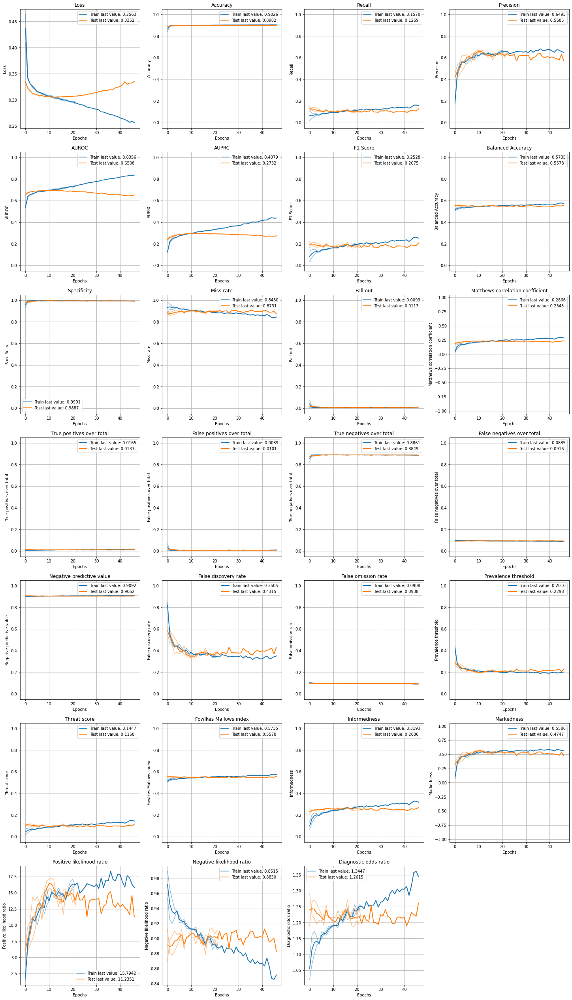

In [39]:
from plot_keras_history import plot_history
plot_history(ffnn_training_histories['active_enhancers_vs_inactive_enhancers'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fe213ec50d0>,
       dtype=object))

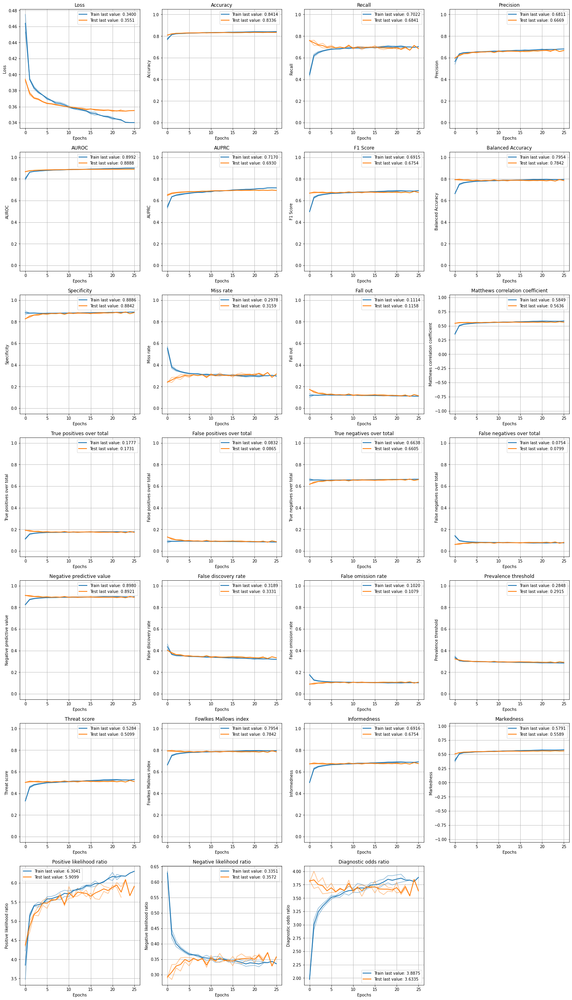

In [40]:
from plot_keras_history import plot_history
plot_history(ffnn_training_histories['active_promoters_vs_inactive_promoters'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fe2903ebbd0>,
       dtype=object))

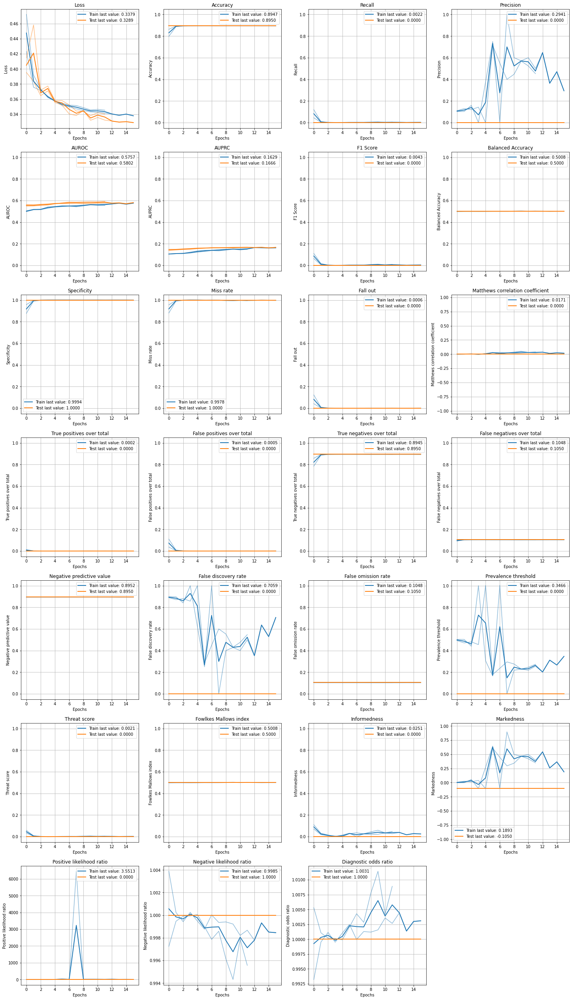

In [42]:
from plot_keras_history import plot_history
plot_history(cnn_training_histories['active_enhancers_vs_inactive_enhancers'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0dc893450>,
       dtype=object))

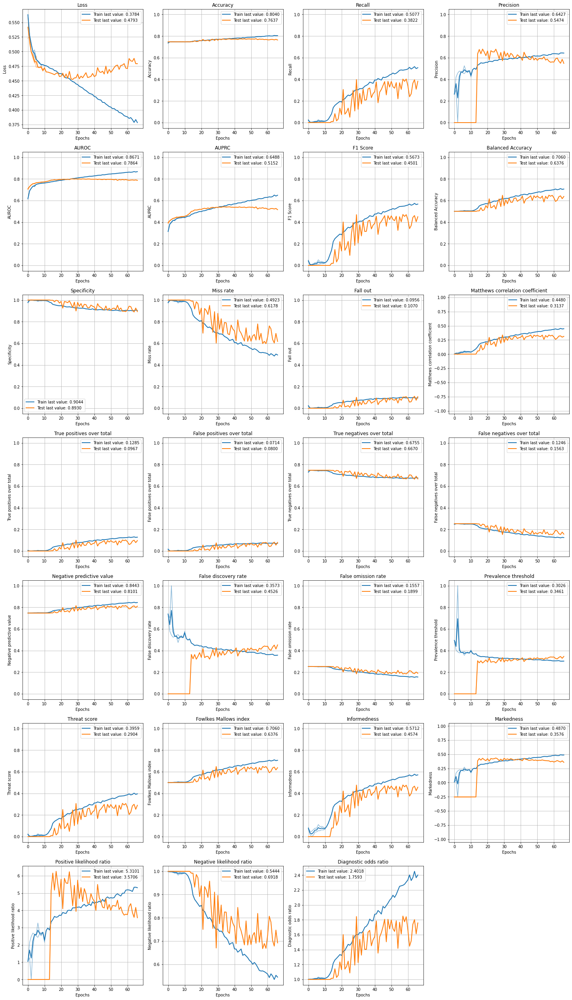

In [50]:
from plot_keras_history import plot_history
plot_history(cnn_training_histories['active_promoters_vs_inactive_promoters'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fe213081d90>,
       dtype=object))

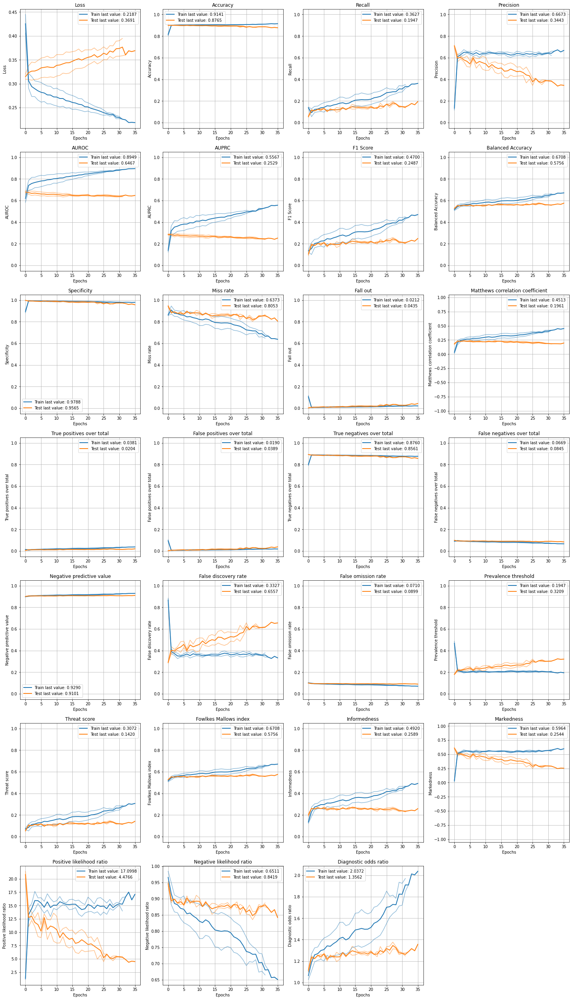

In [44]:
from plot_keras_history import plot_history
plot_history(mmnn_training_histories['active_enhancers_vs_inactive_enhancers'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0e9372110>,
       dtype=object))

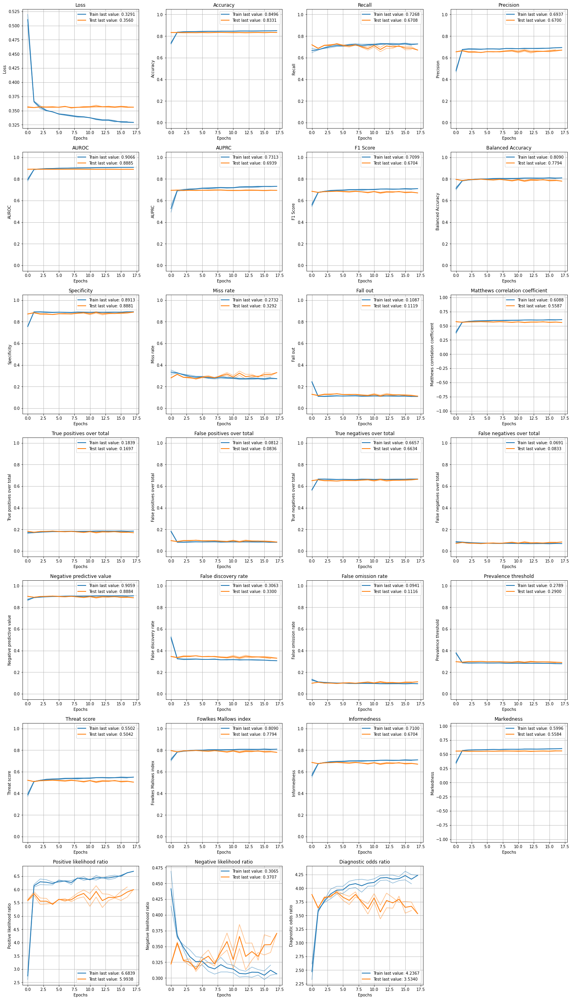

In [45]:
from plot_keras_history import plot_history
plot_history(mmnn_training_histories['active_promoters_vs_inactive_promoters'])

(<Figure size 1440x2520 with 28 Axes>,
 array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0c4df587d0>,
       dtype=object))

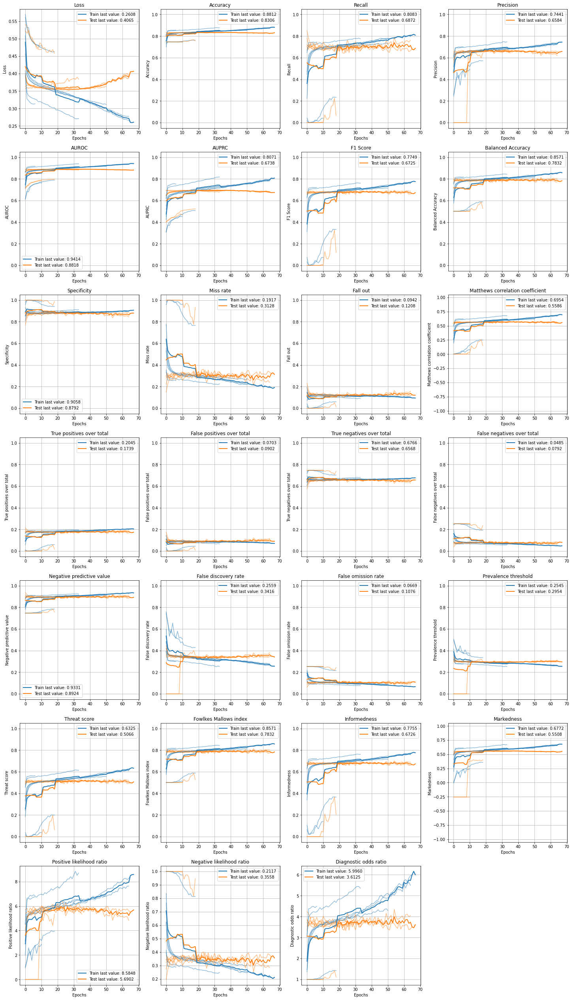

In [ ]:
from plot_keras_history import plot_history
plot_history(training_histories['active_promoters_vs_inactive_promoters'])

Rendering barplots:   0%|          | 0/27 [00:00<?, ?it/s]

[(<Figure size 3200x480 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0e8526ad0>,
        dtype=object)),
 (<Figure size 3200x480 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0e83acbd0>,
        dtype=object)),
 (<Figure size 3200x480 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0e8170350>,
        dtype=object)),
 (<Figure size 3200x480 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0e8029e50>,
        dtype=object)),
 (<Figure size 3200x480 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0e8062390>,
        dtype=object)),
 (<Figure size 3200x480 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0e8029590>,
        dtype=object)),
 (<Figure size 3200x480 with 2 Axes>,
  array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe0e054b750>,
        dtype=object)),
 (<Figure size 3200x480 with 2 Axes>,
  a

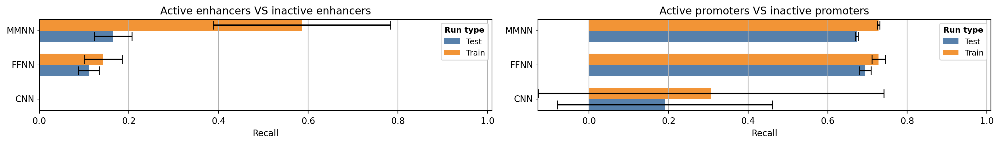

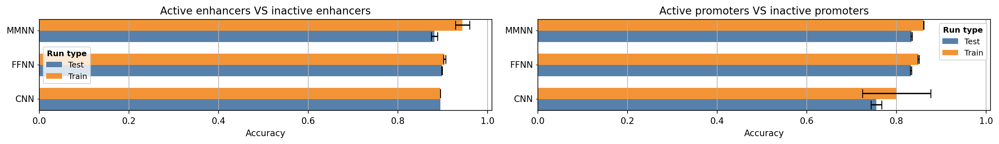

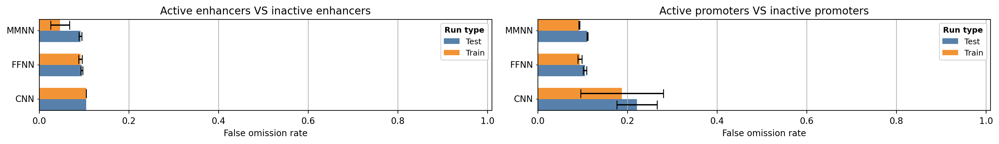

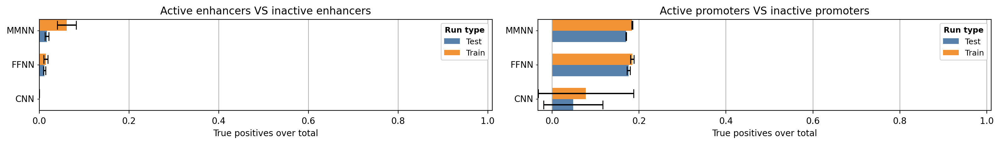

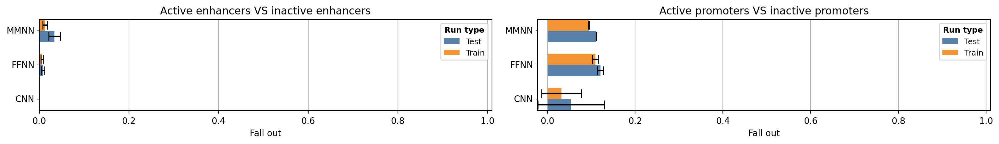

...

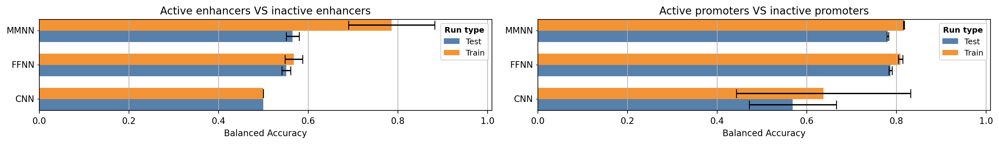

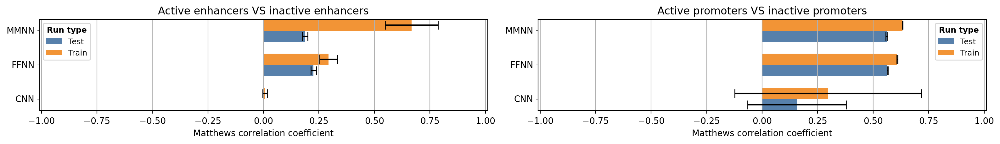

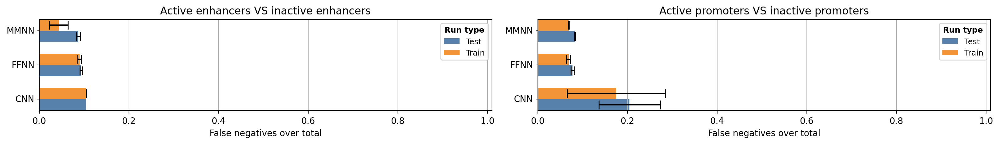

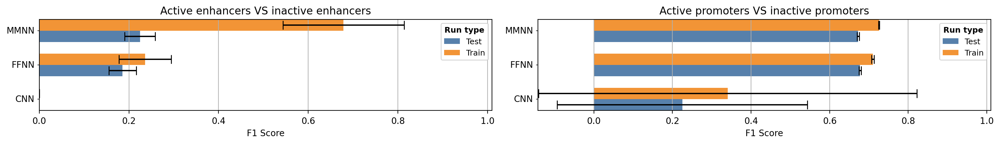

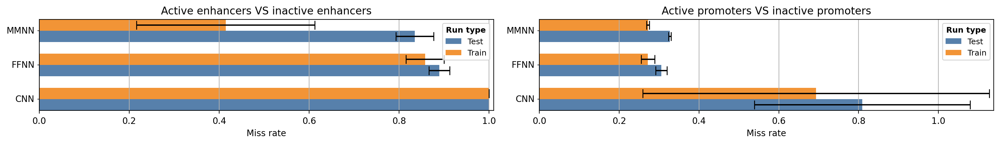

In [46]:
from barplots import barplots

barplots(
   all_performance.drop(columns=["holdout_number"]),
    groupby=["task", "model_name", "run_type"],
    orientation="horizontal",
    height=8,
    subplots=True,
)

WILCOXON TEST

In [49]:
for task in all_performance.task.unique():
  print("*"*80)
  print(task)
  print("*"*80)
  for i  in range(0,2):
    model_A = all_performance.model_name.unique()[i]
    model_A_performance =all_performance[(all_performance.model_name==model_A) & (all_performance.run_type=="test")&(all_performance.task==task)]
    for j in range(i+1,3):
      model_B=all_performance.model_name.unique()[j]
      model_B_performance =all_performance[(all_performance.model_name==model_B) & (all_performance.run_type=="test")&(all_performance.task==task)]
      for metric in ('AUROC','AUPRC','accuracy'):
          _,p_value=wilcoxon(model_A_performance[metric],model_B_performance[metric])
          if p_value <0.01 :
              if model_A_performance[metric].mean()> model_B_performance[metric].mean():
                    best_model,worse_model=model_A,model_B
              else:
                    best_model,worse_model=model_B,model_A
                    print(f"The model {best_model} outperforms the model {worse_model} with p_value {p_value} on metric {metric} ")
          else:
                print(f"The model {model_A} is statistically indistinguishable from {model_B} with p_value {p_value} on metric {metric}")
  






********************************************************************************
active_enhancers_vs_inactive_enhancers
********************************************************************************
The model FFNN is statistically indistinguishable from CNN with p_value 0.17971249487899976 on metric AUROC
The model FFNN is statistically indistinguishable from CNN with p_value 0.17971249487899976 on metric AUPRC
The model FFNN is statistically indistinguishable from CNN with p_value 0.17971249487899976 on metric accuracy
The model FFNN is statistically indistinguishable from MMNN with p_value 0.17971249487899976 on metric AUROC
The model FFNN is statistically indistinguishable from MMNN with p_value 0.17971249487899976 on metric AUPRC
The model FFNN is statistically indistinguishable from MMNN with p_value 0.17971249487899976 on metric accuracy
The model CNN is statistically indistinguishable from MMNN with p_value 0.17971249487899976 on metric AUROC
The model CNN is statistically ind